<Center>

# **`Retail Store Sales Forecasting`**

</Center>

In [479]:
# Data manipulation
import pandas as pd 
import numpy as np

# Data visualization
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
from plotly.offline import iplot

# Datetime Handling
from datetime import datetime

# Data preprocessing
from sklearn.model_selection import train_test_split

# Machine Learning Regressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

# Model Tuning
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV

# Model Evaluation
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt

# Handling warnings
import warnings

In [480]:
features_df = pd.read_csv('C:/Users/Sandeep Sarkar/Desktop/ML Model/Walmart Sales forecasting/Dataset/features.csv')
store_df = pd.read_csv('C:/Users/Sandeep Sarkar/Desktop/ML Model/Walmart Sales forecasting/Dataset/stores.csv')
test_df = pd.read_csv('C:/Users/Sandeep Sarkar/Desktop/ML Model/Walmart Sales forecasting/Dataset/test.csv')
train_df = pd.read_csv('C:/Users/Sandeep Sarkar/Desktop/ML Model/Walmart Sales forecasting/Dataset/train.csv')


In [481]:
train_df.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday
0,1,1,05-02-2010,24924.50,False
1,1,1,12-02-2010,46039.49,True
2,1,1,19-02-2010,41595.55,False
3,1,1,26-02-2010,19403.54,False
4,1,1,05-03-2010,21827.90,False


In [482]:
train_df.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday'], dtype='object')

In [483]:
train_df.shape

(421570, 5)

In [484]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421570 entries, 0 to 421569
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Store         421570 non-null  int64  
 1   Dept          421570 non-null  int64  
 2   Date          421570 non-null  object 
 3   Weekly_Sales  421570 non-null  float64
 4   IsHoliday     421570 non-null  bool   
dtypes: bool(1), float64(1), int64(2), object(1)
memory usage: 13.3+ MB


In [485]:
train_df.describe()

,Store,Dept,Weekly_Sales
count,421570.000000,421570.000000,421570.000000
mean,22.200546,44.260317,15981.258123
std,12.785297,30.492054,22711.183519
min,1.000000,1.000000,-4988.940000
25%,11.000000,18.000000,2079.650000
50%,22.000000,37.000000,7612.030000
75%,33.000000,74.000000,20205.852500
max,45.000000,99.000000,693099.360000


In [486]:
train_df.isnull().sum()

Store           0
Dept            0
Date            0
Weekly_Sales    0
IsHoliday       0
dtype: int64

In [487]:
features_df.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday
0,1,2010-02-05,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False
1,1,2010-02-12,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True
2,1,2010-02-19,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False
3,1,2010-02-26,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False
4,1,2010-03-05,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False


In [488]:
features_df.columns

Index(['Store', 'Date', 'Temperature', 'Fuel_Price', 'MarkDown1', 'MarkDown2',
       'MarkDown3', 'MarkDown4', 'MarkDown5', 'CPI', 'Unemployment',
       'IsHoliday'],
      dtype='object')

In [489]:
features_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         8190 non-null   int64  
 1   Date          8190 non-null   object 
 2   Temperature   8190 non-null   float64
 3   Fuel_Price    8190 non-null   float64
 4   MarkDown1     4032 non-null   float64
 5   MarkDown2     2921 non-null   float64
 6   MarkDown3     3613 non-null   float64
 7   MarkDown4     3464 non-null   float64
 8   MarkDown5     4050 non-null   float64
 9   CPI           7605 non-null   float64
 10  Unemployment  7605 non-null   float64
 11  IsHoliday     8190 non-null   bool   
dtypes: bool(1), float64(9), int64(1), object(1)
memory usage: 712.0+ KB


In [490]:
features_df.shape

(8190, 12)

In [491]:
features_df.describe()

,Store,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment
count,8190.000000,8190.000000,8190.000000,4032.000000,2921.000000,3613.000000,3464.000000,4050.000000,7605.000000,7605.000000
mean,23.000000,59.356198,3.405992,7032.371786,3384.176594,1760.100180,3292.935886,4132.216422,172.460809,7.826821
std,12.987966,18.678607,0.431337,9262.747448,8793.583016,11276.462208,6792.329861,13086.690278,39.738346,1.877259
min,1.000000,-7.290000,2.472000,-2781.450000,-265.760000,-179.260000,0.220000,-185.170000,126.064000,3.684000
25%,12.000000,45.902500,3.041000,1577.532500,68.880000,6.600000,304.687500,1440.827500,132.364839,6.634000
50%,23.000000,60.710000,3.513000,4743.580000,364.570000,36.260000,1176.425000,2727.135000,182.764003,7.806000
75%,34.000000,73.880000,3.743000,8923.310000,2153.350000,163.150000,3310.007500,4832.555000,213.932412,8.567000
max,45.000000,101.950000,4.468000,103184.980000,104519.540000,149483.310000,67474.850000,771448.100000,228.976456,14.313000


In [492]:
features_df.isnull().sum()

Store              0
Date               0
Temperature        0
Fuel_Price         0
MarkDown1       4158
MarkDown2       5269
MarkDown3       4577
MarkDown4       4726
MarkDown5       4140
CPI              585
Unemployment     585
IsHoliday          0
dtype: int64

In [493]:
store_df.head()

,Store,Type,Size
0,1,A,151315
1,2,A,202307
2,3,B,37392
3,4,A,205863
4,5,B,34875


In [494]:
store_df.columns

Index(['Store', 'Type', 'Size'], dtype='object')

In [495]:
store_df.shape

(45, 3)

In [496]:
store_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45 entries, 0 to 44
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Store   45 non-null     int64 
 1   Type    45 non-null     object
 2   Size    45 non-null     int64 
dtypes: int64(2), object(1)
memory usage: 1.2+ KB


In [497]:
store_df.describe()

,Store,Size
count,45.000000,45.000000
mean,23.000000,130287.600000
std,13.133926,63825.271991
min,1.000000,34875.000000
25%,12.000000,70713.000000
50%,23.000000,126512.000000
75%,34.000000,202307.000000
max,45.000000,219622.000000


In [498]:
store_df.isnull().sum()

Store    0
Type     0
Size     0
dtype: int64

In [499]:
test_df.head()

,Store,Dept,Date,IsHoliday
0,1,1,2012-11-02,False
1,1,1,2012-11-09,False
2,1,1,2012-11-16,False
3,1,1,2012-11-23,True
4,1,1,2012-11-30,False


In [500]:
test_df.columns

Index(['Store', 'Dept', 'Date', 'IsHoliday'], dtype='object')

In [501]:
test_df.shape

(115064, 4)

In [502]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 115064 entries, 0 to 115063
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype 
---  ------     --------------   ----- 
 0   Store      115064 non-null  int64 
 1   Dept       115064 non-null  int64 
 2   Date       115064 non-null  object
 3   IsHoliday  115064 non-null  bool  
dtypes: bool(1), int64(2), object(1)
memory usage: 2.7+ MB


In [503]:
test_df.describe()

,Store,Dept
count,115064.000000,115064.000000
mean,22.238207,44.339524
std,12.809930,30.656410
min,1.000000,1.000000
25%,11.000000,18.000000
50%,22.000000,37.000000
75%,33.000000,74.000000
max,45.000000,99.000000


In [504]:
test_df.isnull().sum()

Store        0
Dept         0
Date         0
IsHoliday    0
dtype: int64

In [505]:
# visualizing the types of stores along with occupied percentage:-

labels = store_df['Type'].value_counts()[:10].index
values = store_df['Type'].value_counts()[:10].values

colors = store_df['Type']

fig = go.Figure(data=[go.Pie(labels=labels, values = values,textinfo= 'label+percent',marker=dict(colors=colors))])

fig.show()

In [506]:
# merging same column name of features_fd & stores_df:-
dataset = features_df.merge(store_df,how='inner', on='Store')
dataset.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday,Type,Size
0,1,2010-02-05,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False,A,151315
1,1,2010-02-12,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True,A,151315
2,1,2010-02-19,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False,A,151315
3,1,2010-02-26,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False,A,151315
4,1,2010-03-05,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False,A,151315


In [507]:
dataset.columns

Index(['Store', 'Date', 'Temperature', 'Fuel_Price', 'MarkDown1', 'MarkDown2',
       'MarkDown3', 'MarkDown4', 'MarkDown5', 'CPI', 'Unemployment',
       'IsHoliday', 'Type', 'Size'],
      dtype='object')

In [508]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         8190 non-null   int64  
 1   Date          8190 non-null   object 
 2   Temperature   8190 non-null   float64
 3   Fuel_Price    8190 non-null   float64
 4   MarkDown1     4032 non-null   float64
 5   MarkDown2     2921 non-null   float64
 6   MarkDown3     3613 non-null   float64
 7   MarkDown4     3464 non-null   float64
 8   MarkDown5     4050 non-null   float64
 9   CPI           7605 non-null   float64
 10  Unemployment  7605 non-null   float64
 11  IsHoliday     8190 non-null   bool   
 12  Type          8190 non-null   object 
 13  Size          8190 non-null   int64  
dtypes: bool(1), float64(9), int64(2), object(2)
memory usage: 839.9+ KB


In [509]:
dataset.describe()

,Store,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size
count,8190.000000,8190.000000,8190.000000,4032.000000,2921.000000,3613.000000,3464.000000,4050.000000,7605.000000,7605.000000,8190.000000
mean,23.000000,59.356198,3.405992,7032.371786,3384.176594,1760.100180,3292.935886,4132.216422,172.460809,7.826821,130287.600000
std,12.987966,18.678607,0.431337,9262.747448,8793.583016,11276.462208,6792.329861,13086.690278,39.738346,1.877259,63115.971429
min,1.000000,-7.290000,2.472000,-2781.450000,-265.760000,-179.260000,0.220000,-185.170000,126.064000,3.684000,34875.000000
25%,12.000000,45.902500,3.041000,1577.532500,68.880000,6.600000,304.687500,1440.827500,132.364839,6.634000,70713.000000
50%,23.000000,60.710000,3.513000,4743.580000,364.570000,36.260000,1176.425000,2727.135000,182.764003,7.806000,126512.000000
75%,34.000000,73.880000,3.743000,8923.310000,2153.350000,163.150000,3310.007500,4832.555000,213.932412,8.567000,202307.000000
max,45.000000,101.950000,4.468000,103184.980000,104519.540000,149483.310000,67474.850000,771448.100000,228.976456,14.313000,219622.000000


In [510]:
# Types of stores along with their percentage:-

labels = dataset['Type'].value_counts()[:].index
values = dataset['Type'].value_counts()[:].values

colors = dataset['Type']

fig = go.Figure(data=[go.Pie(labels=labels, values = values,textinfo= 'label+percent',marker=dict(colors=colors))])

fig.show()

In [511]:
# visualizing top 10 departments:-

labels = train_df['Dept'].value_counts()[:10].index
values = train_df['Dept'].value_counts()[:10].values

colors = train_df['Dept']

fig = go.Figure(data=[go.Pie(labels=labels, values = values,textinfo= 'label+percent',marker=dict(colors=colors))])

fig.show()

In [512]:
train_df.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday'], dtype='object')

In [513]:
# visualizing top 10 Stores:-

labels = train_df['Store'].value_counts()[:10].index
values = train_df['Store'].value_counts()[:10].values

colors = train_df['Store']

fig = go.Figure(data=[go.Pie(labels=labels, values = values,textinfo= 'label+percent',marker=dict(colors=colors),hole=0.5)])

fig.show()

In [514]:
# visualizing Holidays :-

labels = train_df['IsHoliday'].value_counts().index
values = train_df['IsHoliday'].value_counts().values

colors = train_df['IsHoliday']

fig = go.Figure(data=[go.Pie(labels=labels, values = values,textinfo= 'label+percent',marker=dict(colors=colors))])

fig.show()

In [515]:
# Converting 'Date' columns to datetime

dataset['Date'] = pd.to_datetime(dataset['Date'], dayfirst=True,errors='coerce')
train_df['Date'] = pd.to_datetime(train_df['Date'], dayfirst=True,errors='coerce')
test_df['Date'] = pd.to_datetime(test_df['Date'], dayfirst=True,errors='coerce')

In [516]:
dataset.info()     

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Store         8190 non-null   int64         
 1   Date          3285 non-null   datetime64[ns]
 2   Temperature   8190 non-null   float64       
 3   Fuel_Price    8190 non-null   float64       
 4   MarkDown1     4032 non-null   float64       
 5   MarkDown2     2921 non-null   float64       
 6   MarkDown3     3613 non-null   float64       
 7   MarkDown4     3464 non-null   float64       
 8   MarkDown5     4050 non-null   float64       
 9   CPI           7605 non-null   float64       
 10  Unemployment  7605 non-null   float64       
 11  IsHoliday     8190 non-null   bool          
 12  Type          8190 non-null   object        
 13  Size          8190 non-null   int64         
dtypes: bool(1), datetime64[ns](1), float64(9), int64(2), object(1)
memory usage: 839.9+ KB


In [517]:
train_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421570 entries, 0 to 421569
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   Store         421570 non-null  int64         
 1   Dept          421570 non-null  int64         
 2   Date          421570 non-null  datetime64[ns]
 3   Weekly_Sales  421570 non-null  float64       
 4   IsHoliday     421570 non-null  bool          
dtypes: bool(1), datetime64[ns](1), float64(1), int64(2)
memory usage: 13.3 MB


In [518]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 115064 entries, 0 to 115063
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Store      115064 non-null  int64         
 1   Dept       115064 non-null  int64         
 2   Date       47204 non-null   datetime64[ns]
 3   IsHoliday  115064 non-null  bool          
dtypes: bool(1), datetime64[ns](1), int64(2)
memory usage: 2.7 MB


In [519]:
dataset['Week']= dataset.Date.dt.isocalendar().week
dataset['Year'] = dataset.Date.dt.year

In [520]:
dataset.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday,Type,Size,Week,Year
0,1,2010-05-02,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False,A,151315,17,2010.0
1,1,2010-12-02,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True,A,151315,48,2010.0
2,1,NaT,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False,A,151315,<NA>,NaN
3,1,NaT,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False,A,151315,<NA>,NaN
4,1,2010-05-03,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False,A,151315,18,2010.0


In [521]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 16 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Store         8190 non-null   int64         
 1   Date          3285 non-null   datetime64[ns]
 2   Temperature   8190 non-null   float64       
 3   Fuel_Price    8190 non-null   float64       
 4   MarkDown1     4032 non-null   float64       
 5   MarkDown2     2921 non-null   float64       
 6   MarkDown3     3613 non-null   float64       
 7   MarkDown4     3464 non-null   float64       
 8   MarkDown5     4050 non-null   float64       
 9   CPI           7605 non-null   float64       
 10  Unemployment  7605 non-null   float64       
 11  IsHoliday     8190 non-null   bool          
 12  Type          8190 non-null   object        
 13  Size          8190 non-null   int64         
 14  Week          3285 non-null   UInt32        
 15  Year          3285 non-null   float64 

In [522]:
dataset.columns

Index(['Store', 'Date', 'Temperature', 'Fuel_Price', 'MarkDown1', 'MarkDown2',
       'MarkDown3', 'MarkDown4', 'MarkDown5', 'CPI', 'Unemployment',
       'IsHoliday', 'Type', 'Size', 'Week', 'Year'],
      dtype='object')

In [523]:
train_df.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday'], dtype='object')

In [524]:
test_df.columns

Index(['Store', 'Dept', 'Date', 'IsHoliday'], dtype='object')

In [525]:
# Merging dataset with train_df & test_df resp:-

train_merge = train_df.merge(dataset,how= 'inner' ,on=['Store','Date','IsHoliday']).sort_values(by=['Store','Dept','Date'])

In [526]:
test_merge = test_df.merge(dataset,how='inner',on=['Store','Date','IsHoliday']).sort_values(by=['Store','Dept','Date'])

In [527]:
test_merge.head()

,Store,Dept,Date,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Type,Size,Week,Year
0,1,1,2012-02-11,False,55.32,3.386,6766.44,5147.70,50.82,3639.90,2737.42,223.462779,6.573,A,151315,6,2012.0
214,1,1,2012-07-12,False,64.12,3.198,6343.16,NaN,270.00,2928.90,10147.90,223.660021,6.573,A,151315,28,2012.0
1,1,1,2012-09-11,False,61.24,3.314,11421.32,3370.89,40.28,4646.79,6154.16,223.481307,6.573,A,151315,37,2012.0
635,1,1,2013-01-02,False,56.46,3.244,9290.91,1359.90,265.00,20657.82,972.61,224.235290,6.525,A,151315,1,2013.0
843,1,1,2013-01-03,False,48.01,3.711,10610.74,261.46,2.80,25.54,2747.59,224.564526,6.525,A,151315,1,2013.0


In [528]:
train_merge.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday', 'Temperature',
       'Fuel_Price', 'MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4',
       'MarkDown5', 'CPI', 'Unemployment', 'Type', 'Size', 'Week', 'Year'],
      dtype='object')

In [529]:
def scatter (train_merge,columns):
    plt.figure
    plt.scatter(train_merge[columns], train_merge['Weekly_Sales'])
    plt.ylabel('Weekly_Sales')
    plt.xlabel(columns)
    plt.title(f' Weekly_Sales vs {columns}')
    plt.show()

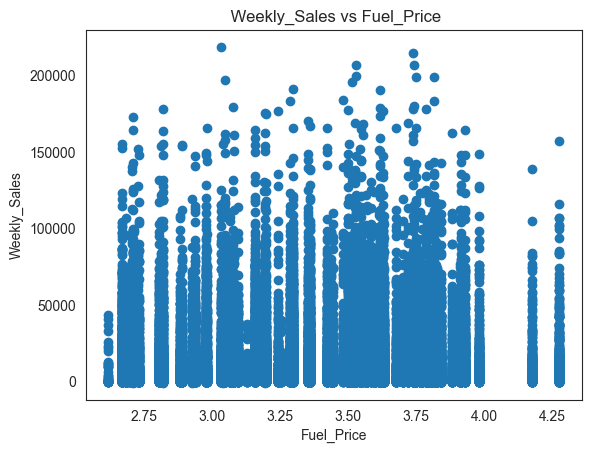

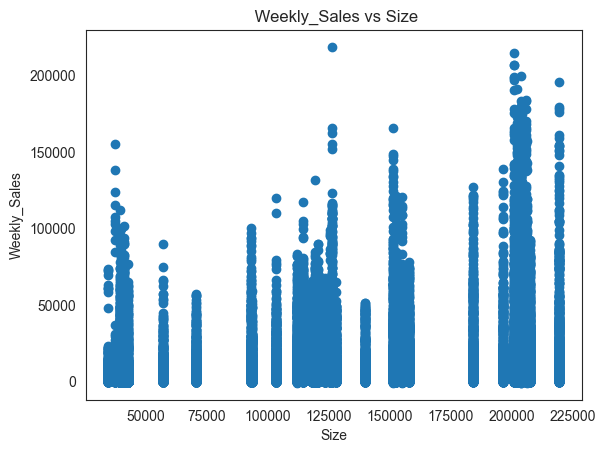

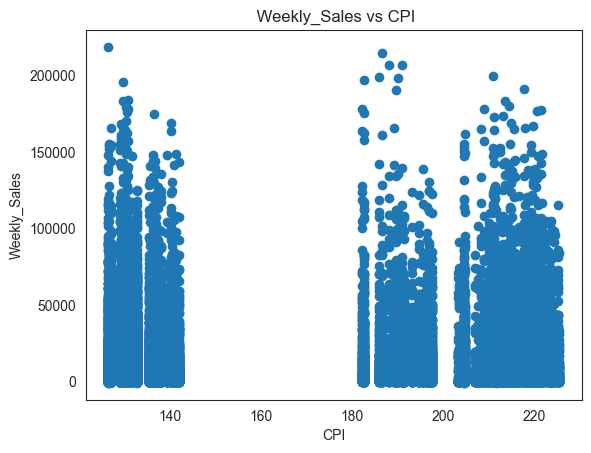

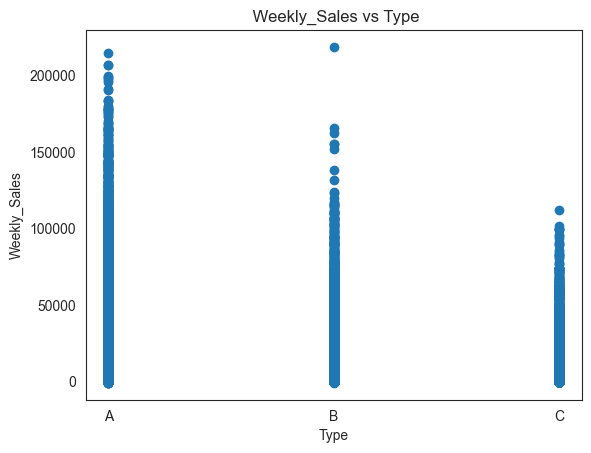

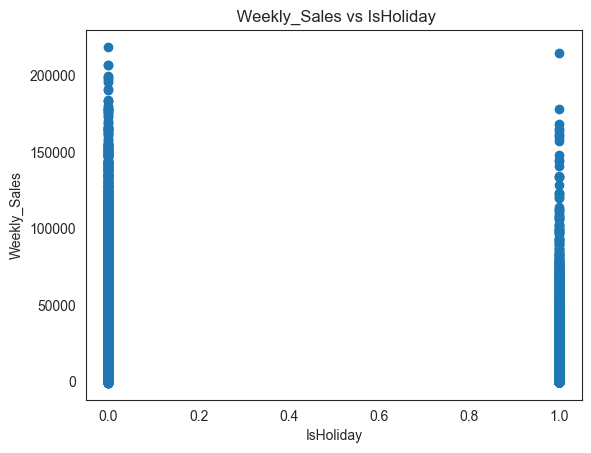

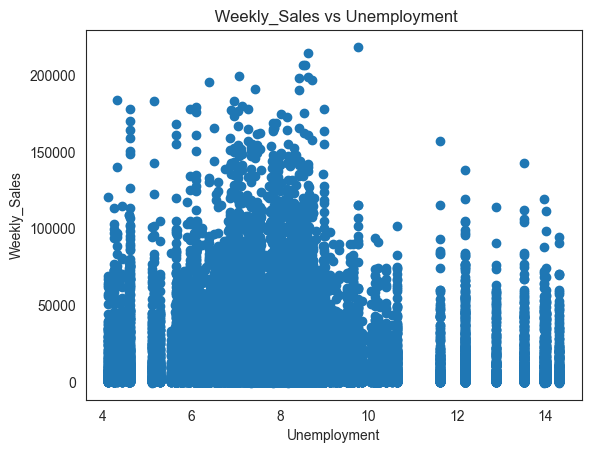

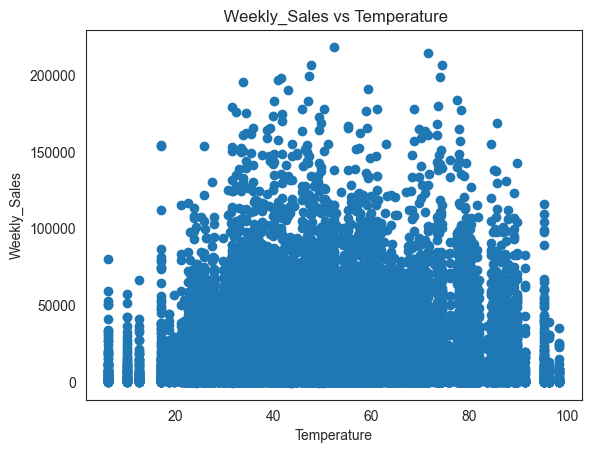

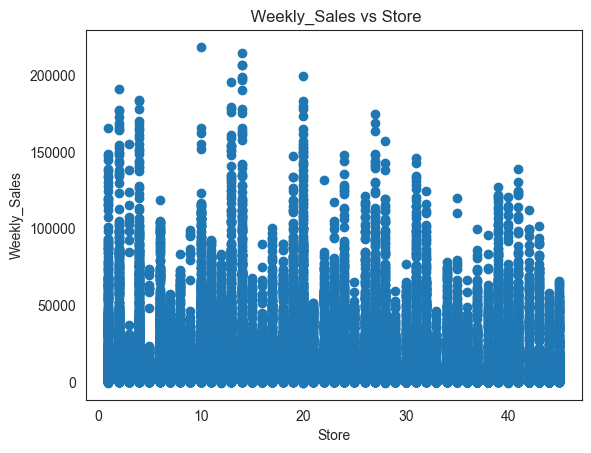

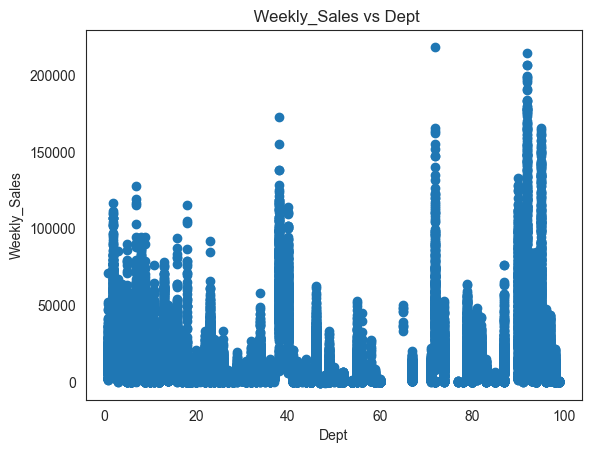

In [530]:
scatter(train_merge,'Fuel_Price')
scatter(train_merge,'Size')
scatter(train_merge,'CPI')
scatter(train_merge,'Type')
scatter(train_merge,'IsHoliday')
scatter(train_merge,'Unemployment')
scatter(train_merge,'Temperature')
scatter(train_merge,'Store')
scatter(train_merge,'Dept')

Text(0.5, 1.0, 'Avg.Sales for the year 2010')

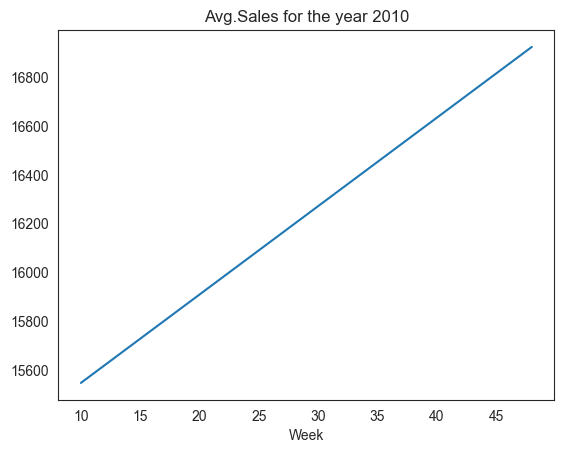

In [531]:
# Avg. Weekely sales for year 2010.

weekly_sales_2010 = train_merge[train_merge['Year']==2010]['Weekly_Sales'].groupby(train_merge['Week']).mean()

sns.lineplot(x=weekly_sales_2010.index,y= weekly_sales_2010.values)
plt.title('Avg.Sales for the year 2010')

Text(0.5, 1.0, 'Avg.Sales for the year 2011')

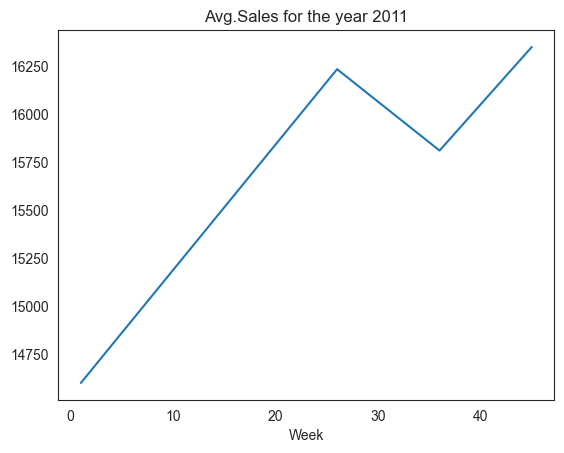

In [532]:
# Avg. Weekely sales for year 2011.

weekly_sales_2011 = train_merge[train_merge['Year']==2011]['Weekly_Sales'].groupby(train_merge['Week']).mean()

sns.lineplot(x=weekly_sales_2011.index,y=weekly_sales_2011.values)
plt.title('Avg.Sales for the year 2011')

Text(0.5, 1.0, 'Avg.Sales for the year 2012')

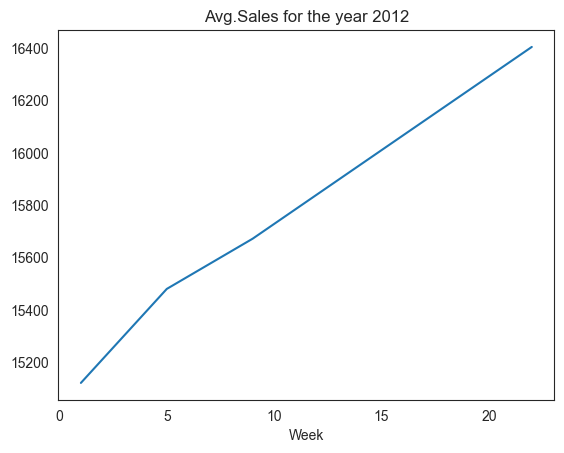

In [533]:
# Avg. Weekely sales for year 2012.

weekly_sales_2012 = train_merge[train_merge['Year']==2012]['Weekly_Sales'].groupby(train_merge['Week']).mean()

sns.lineplot(x=weekly_sales_2012.index,y= weekly_sales_2012.values)
plt.title('Avg.Sales for the year 2012')

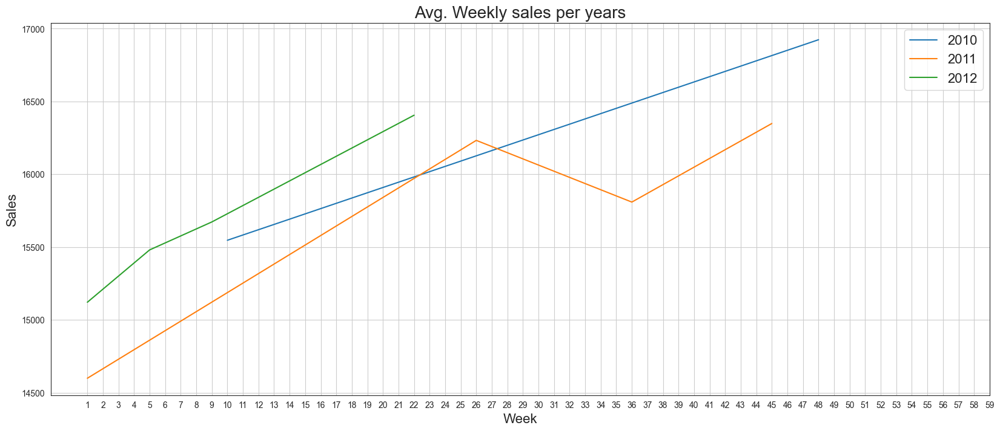

In [534]:
# Plotting all 3 graphs in one:-

plt.figure(figsize=(20,8))
sns.lineplot(x=weekly_sales_2010.index,y= weekly_sales_2010.values,label='2010')
sns.lineplot(x=weekly_sales_2011.index,y= weekly_sales_2011.values,label='2011')
sns.lineplot(x=weekly_sales_2012.index,y= weekly_sales_2012.values,label='2012')
plt.grid(True)
plt.xticks(np.arange(min(weekly_sales_2010.index), max(weekly_sales_2012.index) + 1, step=1))
plt.xticks(np.arange(1,60, step=1))
plt.legend(loc ='best',fontsize=16)
plt.title('Avg. Weekly sales per years', fontsize=20)
plt.xlabel('Week',fontsize=16)
plt.ylabel('Sales',fontsize=16)
plt.show()

C:\Users\Sandeep Sarkar\AppData\Local\Temp\ipykernel_19904\917396727.py:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




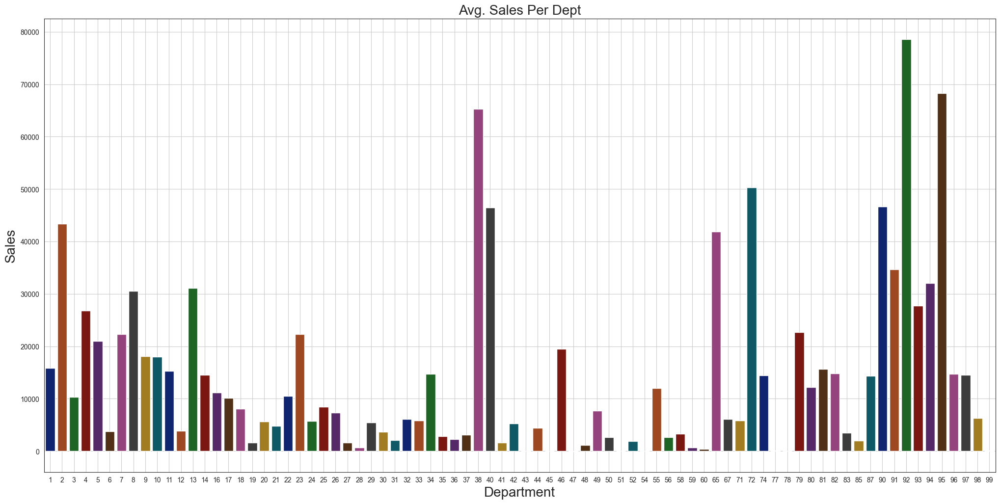

In [535]:
# Avg. Sales per Dept:-

weekly_sales = train_merge['Weekly_Sales'].groupby(train_merge['Dept']).mean()
plt.figure(figsize=(25,12))
sns.barplot(x=weekly_sales.index,y= weekly_sales.values, palette='dark')
plt.grid()
plt.title('Avg. Sales Per Dept',fontsize= 20)
plt.xlabel('Department',fontsize= 20)
plt.ylabel('Sales',fontsize= 20)
plt.show()

C:\Users\Sandeep Sarkar\AppData\Local\Temp\ipykernel_19904\1574197244.py:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




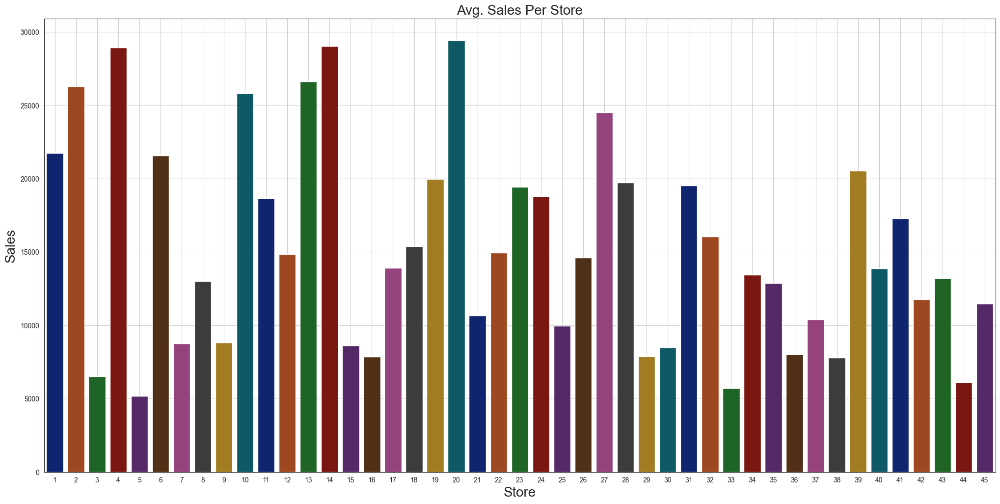

In [536]:
# Avg. Sales per Store:-

weekly_sales = train_merge['Weekly_Sales'].groupby(train_merge['Store']).mean()
plt.figure(figsize=(25,12))
sns.barplot(x=weekly_sales.index,y= weekly_sales.values, palette='dark')
plt.grid()
plt.title('Avg. Sales Per Store',fontsize= 20)
plt.xlabel('Store',fontsize= 20)
plt.ylabel('Sales',fontsize= 20)
plt.show()

In [537]:
train_merge.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday', 'Temperature',
       'Fuel_Price', 'MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4',
       'MarkDown5', 'CPI', 'Unemployment', 'Type', 'Size', 'Week', 'Year'],
      dtype='object')

In [538]:
# train_merge.head()

In [539]:
# Convert Categorical Columns:-

train_merge_encoded = pd.get_dummies(train_merge, drop_first=True)

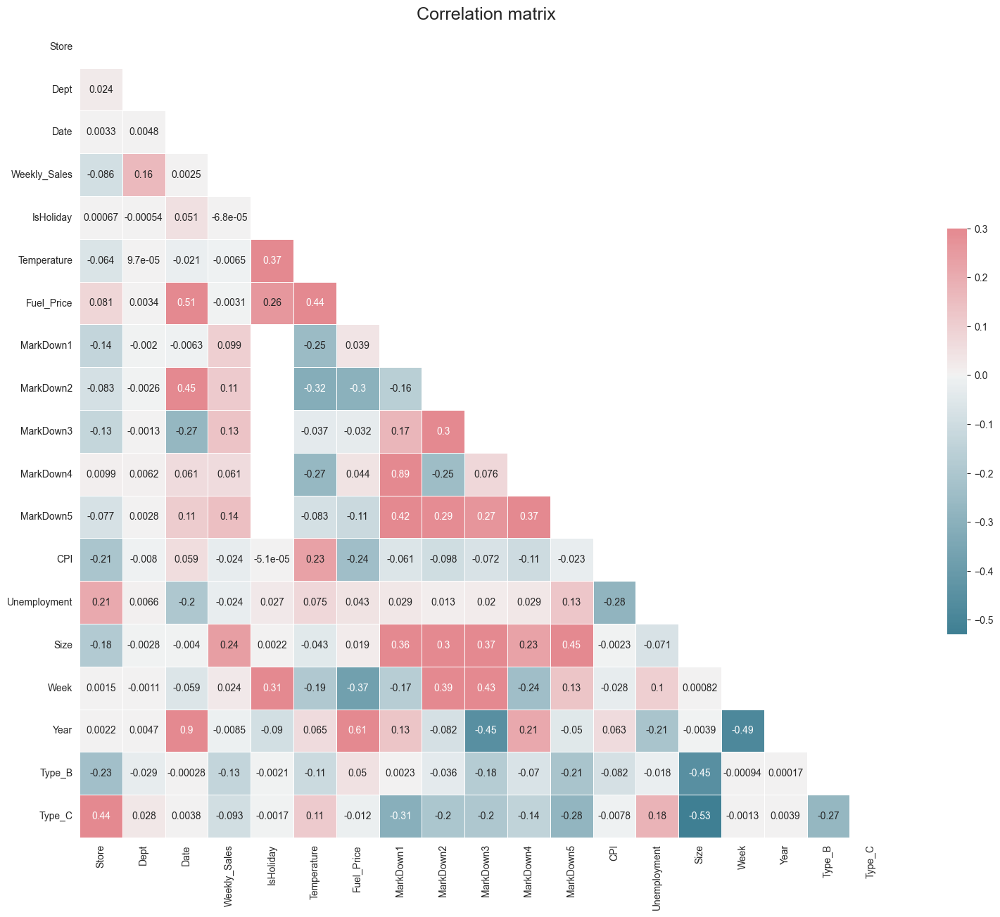

In [540]:
# Checking Co-relation with heat map:-

# Set the style of the visualization
sns.set_style('white')

# Compute the correlation matrix
corr= train_merge_encoded.corr()

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(corr,dtype=np.bool_))

# Create a figure and axes object
f, ax = plt.subplots(figsize=(20,15))

# Define the color map
cmap = sns.diverging_palette(220,10,as_cmap=True)

plt.title('Correlation matrix', fontsize= 18)

# Create the heatmap
sns.heatmap(corr,mask=mask,cmap=cmap, vmax=.3,center= 0, square= True, linewidths=.5, cbar_kws={'shrink' : .5}, annot=True, ax=ax)

plt.show()

In [541]:
# Dropping down the values which have Weak Correlation:-

train_merge= train_merge.drop(columns=['Fuel_Price', 'MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4', 'MarkDown5'])
test_merge= test_merge.drop(columns=['Fuel_Price', 'MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4', 'MarkDown5'])

In [542]:
train_merge.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday', 'Temperature',
       'CPI', 'Unemployment', 'Type', 'Size', 'Week', 'Year'],
      dtype='object')

In [543]:
test_merge.columns

Index(['Store', 'Dept', 'Date', 'IsHoliday', 'Temperature', 'CPI',
       'Unemployment', 'Type', 'Size', 'Week', 'Year'],
      dtype='object')

In [544]:
train_merge.shape

(29570, 12)

In [545]:
# Divide the data into train and test:-

X= train_merge[['Store', 'Dept','IsHoliday','Size', 'Week', 'Year']]
y = train_merge['Weekly_Sales']

In [546]:
# split the data for train & test:-

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3 ,random_state=42)

In [547]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 20699 entries, 14826 to 23654
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Store      20699 non-null  int64  
 1   Dept       20699 non-null  int64  
 2   IsHoliday  20699 non-null  bool   
 3   Size       20699 non-null  int64  
 4   Week       20699 non-null  UInt32 
 5   Year       20699 non-null  float64
dtypes: UInt32(1), bool(1), float64(1), int64(3)
memory usage: 929.8 KB


# **Decision-Tree Regressor**

In [548]:
#performing grid search CV On DECISION-TREE regression:-

depth = list(range(3,30))
params_grid= dict(max_depth=depth)
tree= GridSearchCV(DecisionTreeRegressor(),params_grid, cv=10)
tree.fit(X_train,y_train)

GridSearchCV(cv=10, estimator=DecisionTreeRegressor(),
             param_grid={'max_depth': [3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14,
                                       15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                       25, 26, 27, 28, 29]})

In [549]:
#predicting train & test rsults:-

y_train_pred= tree.predict(X_train)
y_test_pred= tree.predict(X_test)

**Predicting Train Result**

In [ ]:
print(sqrt(mean_squared_error(y_train.values,y_train_pred)))
print(r2_score(y_train.values,y_train_pred))

35.05644163298934
0.9999975302097484


**Predicting Test Result**

In [ ]:
print(sqrt(mean_squared_error(y_test.values,y_test_pred)))
print(r2_score(y_test.values,y_test_pred))

6040.034444587495
0.9310559375517875


**Plotting Actual vs predicted of Train Data**

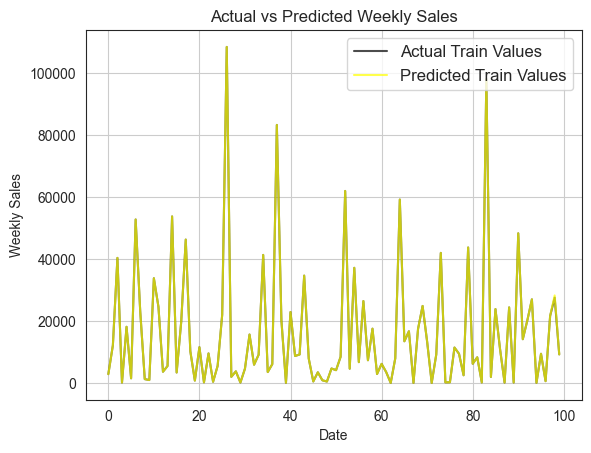

In [ ]:
plt.plot(y_train.values[:100], label='Actual Train Values', color='k', alpha=0.7)  
plt.plot(y_train_pred[:100], label='Predicted Train Values', color='yellow', alpha=0.7)


plt.title('Actual vs Predicted Weekly Sales')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend(loc='best', fontsize=12)
plt.grid(True)
plt.show()



**Plotting Actual vs predicted of Test Data**

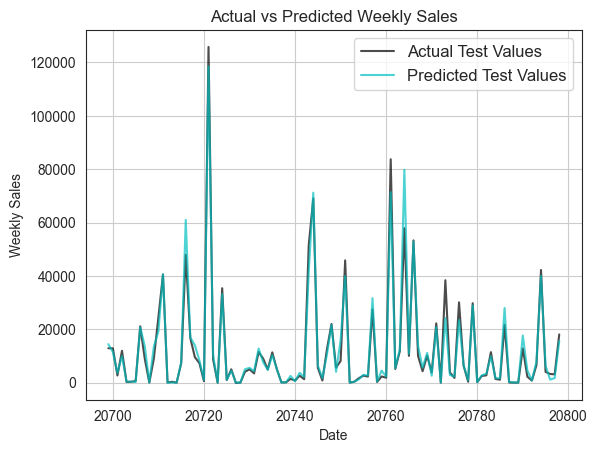

In [ ]:
plt.plot(np.arange(len(y_train), len(y_train) + len(y_test))[:100], y_test.values[:100], label='Actual Test Values', color='k', alpha=0.7)  
plt.plot(np.arange(len(y_train), len(y_train) + len(y_test))[:100], y_test_pred[:100], label='Predicted Test Values', color='c', alpha=0.7)

plt.title('Actual vs Predicted Weekly Sales')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend(loc='best', fontsize=12)
plt.grid(True)
plt.show()



# **Random Forest Regressor**

In [554]:
# performing Random search CV On RANDOM-FOREST regression:-

tuned_params_1= {
    'n_estimators': [100,200],
    'min_samples_split':[2,5,10],
    'min_samples_leaf':[1,2,4],
    # 'max_depth':[10,20,30,40,50,60,70,80,90,100,110,None]
    }
random_regressor= RandomizedSearchCV(estimator=RandomForestRegressor(),param_distributions=tuned_params_1,n_iter=2,scoring='neg_mean_absolute_error',n_jobs=-1)
random_regressor.fit(X_train,y_train)

RandomizedSearchCV(estimator=RandomForestRegressor(), n_iter=2, n_jobs=-1,
                   param_distributions={'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [100, 200]},
                   scoring='neg_mean_absolute_error')

In [555]:
# predicting train & test rsults:-

y_train_pred= random_regressor.predict(X_train)
y_test_pred= random_regressor.predict(X_test)

**Predicting Train Result**

In [ ]:
print(sqrt(mean_squared_error(y_train.values,y_train_pred)))
print(r2_score(y_train.values,y_train_pred))

3507.5850942542083
0.9752747414879617


**Predicting Test Result**

In [ ]:
# :-

print(sqrt(mean_squared_error(y_test.values,y_test_pred)))
print(r2_score(y_test.values,y_test_pred))

5006.312816371122
0.9526353857074973


**Plotting Actual vs predicted of Train Data**

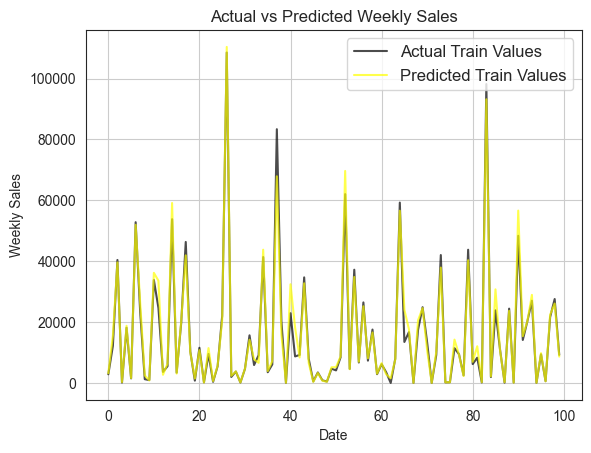

In [558]:
# Plot for Train Data
plt.plot(y_train.values[:100], label='Actual Train Values', color='k', alpha=0.7)  
plt.plot(y_train_pred[:100], label='Predicted Train Values', color='yellow', alpha=0.7)


plt.title('Actual vs Predicted Weekly Sales')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend(loc='best', fontsize=12)
plt.grid(True)
plt.show()

**Plotting Actual vs predicted of Test Data**

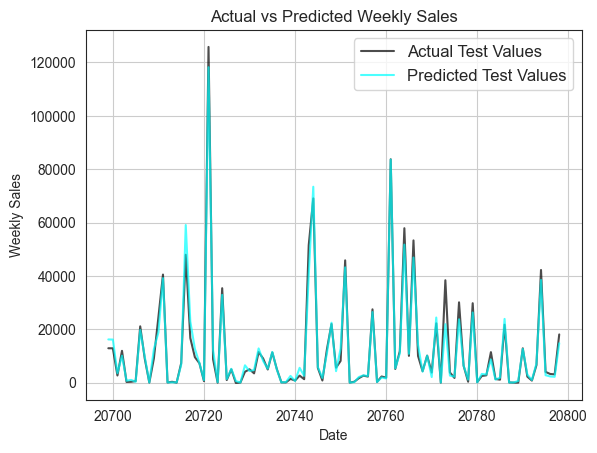

In [559]:
# Plot for Test Data
plt.plot(np.arange(len(y_train), len(y_train) + len(y_test))[:100], y_test.values[:100], label='Actual Test Values', color='k', alpha=0.7)  
plt.plot(np.arange(len(y_train), len(y_train) + len(y_test))[:100], y_test_pred[:100], label='Predicted Test Values', color='cyan',  alpha=0.7)

plt.title('Actual vs Predicted Weekly Sales')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend( loc='best',fontsize=12)
plt.grid(True)
plt.show()